In [1]:
import networkx as nx
import networkit as nk
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import re
import pickle
import multiprocessing as mp
import time
import random
from collections import Counter
import pandas as pd
import matplotlib.dates as mdates
from scipy import stats
from functools import partial
import os
import datetime as dt
import glob
from tqdm import tqdm
from fa2 import ForceAtlas2


In [2]:
sys.path.insert(1,'../helpers')
import destino

### Description

In this notebook we draw the network layout utilized in main Figure 1. Coordinates computed by Gephi's ForceAtlas2 were utilized for the final version. FA2 package is implemented for Python, though. Here we show both approaches.

In [15]:
alphab=['A','B','C','D','E','F','G','H','I','J','K','L','M','N','O','P','Q',
        'R','S','T','U','V','W','X','Y','Z','AA','AB','AC','AD','AE','AF','AG']
comtodraw=alphab[:15]
com2type={'A':'Other','B':'International expert','C':'Political',
         'D':'National elite','E':'Other','F':'Political',
          'G':'International expert','H':'Political','I':'National elite',
          'J':'National elite','K':'National elite',
          'L':'Political','M':'National elite',
          'N':'Other', 'O':'Other','XX':'Other'
         }    

palette = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b',    '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
type2col = {'International expert': palette[4], 'National elite': palette[1], 'Political': palette[2], 'Other': '.5'} 

com2col={'A':'black','B':'red','C':'orchid','D':'deepskyblue','E':'orange',
        'F':'darkseagreen','G':'deeppink','H':'blue','I':'yellow','J':'brown','K':'cyan',
        'L':'lime','M':'green','N':'slateblue'}
for com in comtodraw:
    if com not in list(com2col.keys()):
         com2col[com]='grey'
com2col['XX']='grey'

In [4]:
com_of_user,how_many_best,com_ids=destino.load_communities('data/com_of_user_letters_1_30.pickle',
                                                           c_ids=True,verbose=False)
pop=len(com_of_user.keys())
com2size={com:len(ids)/pop for com,ids in com_ids.items()}

In [35]:
#Actual 1M random subsampling proportions
print(com2size)

{'A': 0.3329531445880799, 'AA': 8.862794221797158e-05, 'AB': 4.928730556157956e-05, 'B': 0.10556707475960952, 'C': 0.09952284535748819, 'D': 0.09445727004706514, 'E': 0.07208016426366148, 'F': 0.06863825999129511, 'G': 0.06406801095079181, 'H': 0.054324557397765864, 'I': 0.02074638732971013, 'J': 0.020357173729411177, 'K': 0.018870882692376828, 'L': 0.011245132934330665, 'M': 0.008305959178692398, 'N': 0.005966707830115891, 'O': 0.005535789586649447, 'P': 0.004331172155607294, 'Q': 0.004295578246251511, 'R': 0.00350247636372622, 'S': 0.0020983011000302145, 'T': 0.0007746358694008617, 'U': 0.0005389488806339962, 'V': 0.0004676272502331223, 'W': 0.00035928438579051886, 'X': 0.0003176243465194643, 'Y': 0.000294831755440761, 'Z': 0.00024224376154293085}


# Force Atlas 2

In [5]:
#Here we load the network with layout computed by FA2 in Gephi
#strongerGravity=True
#gravity=0.05
#other parameters have Gephi 0.9.2 defaults
filen='1Mtopy_005'
Gcomp=nx.read_graphml('data/'+filen+'.graphml')
print(nx.info(Gcomp))

Name: 
Type: DiGraph
Number of nodes: 1014734
Number of edges: 3035854
Average in degree:   2.9918
Average out degree:   2.9918


In [6]:
sizes=np.array([Gcomp.nodes[u]['Weighted Out-Degree'] for u in Gcomp.nodes])
sizes=np.interp(sizes, (sizes.min(), sizes.max()), (.5, 1000))
x=np.array([Gcomp.nodes[u]['x'] for u in Gcomp.nodes])
y=np.array([Gcomp.nodes[u]['y'] for u in Gcomp.nodes])
pos_i={u:(Gcomp.nodes[u]['x'],Gcomp.nodes[u]['y']) for u in Gcomp.nodes}


In [22]:
#You can also compute FA2 layout directly from Python (not parallelized,much slower)
forceatlas2 = ForceAtlas2(
                        # Behavior alternatives
                        outboundAttractionDistribution=False,  # Dissuade hubs
                        linLogMode=False,  # NOT IMPLEMENTED
                        adjustSizes=False,  # Prevent overlap (NOT IMPLEMENTED)
                        edgeWeightInfluence=1.0,

                        # Performance
                        jitterTolerance=1.0,  # Tolerance
                        barnesHutOptimize=True,
                        barnesHutTheta=1.2,
                        multiThreaded=False,  # NOT IMPLEMENTED

                        # Tuning
                        scalingRatio=2,
                        strongGravityMode=True,
                        gravity=0.05,

                        # Log
                        verbose=True)

In [ ]:
s_t=time.time()
positions = forceatlas2.forceatlas2_networkx_layout(Gcomp, pos=pos_i, 
                                                    iterations=100)
e_t=time.time()-s_t
print('Elapsed time: {} min'.format(e_t/60))

 26%|██▌       | 26/100 [44:11<2:13:03, 107.88s/it]

In [37]:
with open('data/pos_2_5_400_150_False.pickle','wb') as f:
    pickle.dump(positions,f)

In [38]:
xfa=[p[0] for p in list(positions.values())]
yfa=[p[1] for p in list(positions.values())]

Elapsed time: 0.032969955603281656 min


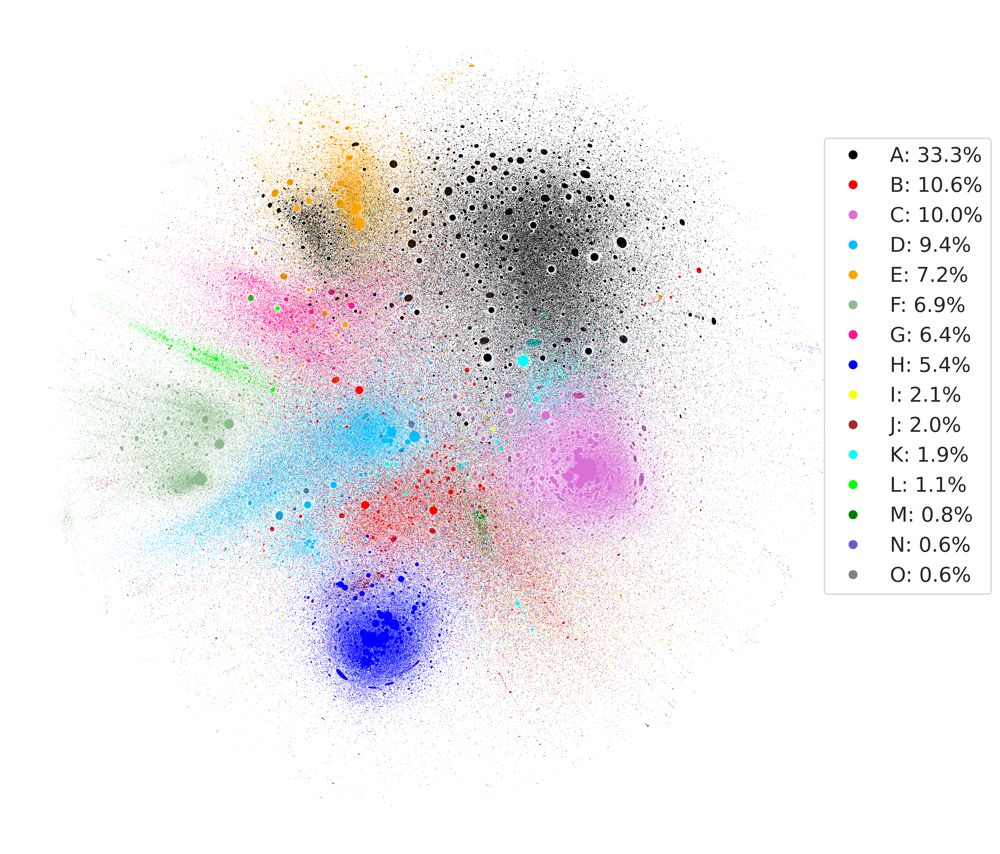

In [19]:
#Figure 1
#jo='O'
colors=[com2col[Gcomp.nodes[u]['Label']] for u in Gcomp.nodes]
#colors=[com2col[jo] if com_of_user[u]==jo else 'lightgrey' for u in Gcomp.nodes]
s_t=time.time()
f=plt.figure(dpi=500,figsize=(12,12))
plt.scatter(x,y,c=colors,s=sizes,alpha=1,
            marker='.',edgecolors=None,linewidths=0)
markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for com,color in com2col.items() if com!='XX']
scritte=[l+': {:.1f}%'.format(100*com2size[l]) for l in alphab[:15]]
plt.legend(markers, scritte, numpoints=1,loc=(.95,.3),#'upper right',
          fontsize=16)
plt.axis('off')
e_t=time.time()-s_t
print('Elapsed time: {} min'.format(e_t/60))

Elapsed time: 0.2422349174817403 min


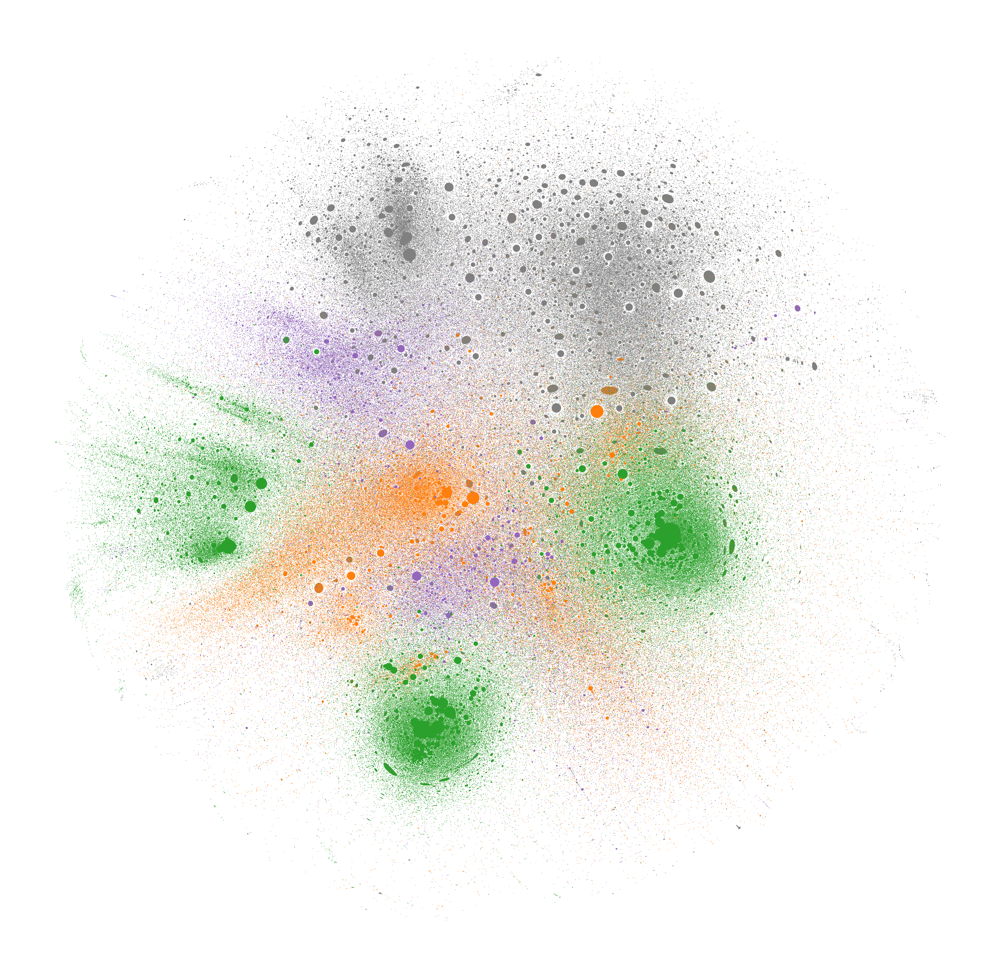

In [28]:
#Super-community colouring
#NOT SHOWN IN THE PAPER
s_t=time.time()
colors=[type2col[com2type[Gcomp.nodes[u]['Label']]] for u in Gcomp.nodes]
f=plt.figure(dpi=500,figsize=(12,12))
plt.scatter(x,y,c=colors,s=sizes,alpha=1,
            marker='.',edgecolors=None,linewidths=0)
markers = [plt.Line2D([0,0],[0,0],color=color, marker='o', linestyle='') for color in type2col.values()]
#plt.legend(markers, type2col.keys(), numpoints=1,loc='upper right')
plt.axis('off')

plt.savefig('images/'+filen+'_types.png')
e_t=time.time()-s_t
print('Elapsed time: {} min'.format(e_t/60))